# Taxi Fare Guru: Total Amount Prediction Challenge!

### Problem Overview:
In this exciting challenge,we are tasked with building predictive models to estimate the total amount paid by travelers for taxi journeys. The dataset includes a variety of features, and the goal is to create accurate models that can predict the 'total_amount' for taxi rides.

#### Dataset Overview
This dataset presents an opportunity to construct predictive models aimed at estimating the total amount paid by travelers for taxi journeys. With access to a training set containing the target variable 'total_amount' along with various informative features, participants are challenged to create accurate predictive models.

#### Data Files
The dataset is composed of the following files:

<b>train.csv:</b> The training set, which includes the target variable 'total_amount' and accompanying feature attributes.

<b>test.csv:</b> The test set, containing similar feature attributes but without the target variable 'total_amount,' as it is the variable to be predicted.

<b>sample_submission.csv:</b> A sample submission file provided in the correct format for competition submissions.

#### Columns Description

The dataset comprises various columns, each offering valuable insights into taxi rides. Notably:

<b>total_amount:</b> The total amount paid by the traveler for the taxi ride.

<b>VendorID:</b> An identifier for taxi vendors.

<b>tpep_pickup_datetime and tpep_dropoff_datetime:</b> Timestamps indicating pickup and dropoff times.

<b>passenger_count:</b> The number of passengers during the ride.

<b>trip_distance:</b> The distance traveled during the trip.

<b>RatecodeID:</b> Rate code for the ride.

<b>store_and_fwd_flag:</b> A flag indicating whether the trip data was stored and forwarded.

<b>PULocationID and DOLocationID:</b> Pickup and dropoff location identifiers.

<b>payment_type:</b> Payment type used for the ride.

Other columns are self-explanatory and contribute to the modeling process.

Importing every needed library for this project.


In [88]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import os
import warnings
warnings.filterwarnings('ignore')
sns.set(style="whitegrid")


from sklearn.impute import SimpleImputer
from sklearn.preprocessing import StandardScaler,MinMaxScaler,RobustScaler,LabelEncoder,OneHotEncoder,OrdinalEncoder
from sklearn.model_selection import train_test_split,GridSearchCV,RandomizedSearchCV,cross_val_score
from sklearn.metrics import mean_absolute_error,mean_squared_error,r2_score
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
from sklearn.linear_model import LinearRegression,SGDRegressor,PassiveAggressiveRegressor,RidgeCV,LassoCV,ElasticNetCV
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor,GradientBoostingRegressor,AdaBoostRegressor
from sklearn.svm import SVR
from xgboost import XGBRegressor
from sklearn.neural_network import MLPRegressor


Reading the CSV data

In [2]:
train = pd.read_csv('train.csv')
test = pd.read_csv('test.csv')
train.head(10)

,VendorID,tpep_pickup_datetime,tpep_dropoff_datetime,passenger_count,trip_distance,RatecodeID,store_and_fwd_flag,PULocationID,DOLocationID,payment_type,extra,tip_amount,tolls_amount,improvement_surcharge,total_amount,congestion_surcharge,Airport_fee
0,1,2023-06-28 17:20:21,2023-06-28 16:34:45,1.0,2.14,1.0,N,120,9,Credit Card,2.5,7.165589,0.0,1.0,20.64,2.5,0.0
1,0,2023-06-29 23:05:01,2023-06-29 22:01:35,1.0,2.70,1.0,N,15,215,Credit Card,3.5,6.067401,0.0,1.0,25.55,2.5,0.0
2,1,2023-06-30 10:19:31,2023-06-30 11:13:10,1.0,1.15,1.0,N,167,223,Credit Card,0.0,4.111547,0.0,1.0,17.64,2.5,0.0
3,0,2023-06-29 13:23:09,2023-06-29 14:20:01,1.0,0.40,1.0,N,128,239,Credit Card,2.5,6.411079,0.0,1.0,12.80,2.5,0.0
4,1,2023-06-29 22:03:32,2023-06-29 22:22:22,3.0,1.10,1.0,N,203,52,Credit Card,1.0,4.769377,0.0,1.0,18.00,2.5,0.0
5,0,2023-06-29 16:31:14,2023-06-29 16:29:06,1.0,0.00,99.0,N,225,256,Credit Card,0.0,1.507831,0.0,1.0,44.70,0.0,0.0
6,1,2023-06-30 12:54:57,2023-06-30 11:52:20,1.0,1.33,1.0,N,214,240,Cash,0.0,0.094334,0.0,1.0,18.20,2.5,0.0
7,1,2023-06-30 17:16:44,2023-06-30 17:40:34,1.0,0.45,1.0,N,176,227,Cash,2.5,0.727105,0.0,1.0,13.70,2.5,0.0
8,0,2023-06-30 21:52:44,2023-06-30 21:54:13,3.0,3.80,1.0,N,196,139,Credit Card,3.5,6.590745,0.0,1.0,35.60,2.5,0.0
9,1,2023-06-29 11:12:12,2023-06-29 09:39:24,1.0,2.50,1.0,N,138,196,Credit Card,0.0,6.091603,0.0,1.0,23.10,2.5,0.0


In [3]:
train.shape, test.shape

((175000, 17), (50000, 16))

In [4]:
df = pd.concat([train, test], axis=0)


#### Preliminary Data Inspection

In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 225000 entries, 0 to 49999
Data columns (total 17 columns):
 #   Column                 Non-Null Count   Dtype  
---  ------                 --------------   -----  
 0   VendorID               225000 non-null  int64  
 1   tpep_pickup_datetime   225000 non-null  object 
 2   tpep_dropoff_datetime  225000 non-null  object 
 3   passenger_count        217144 non-null  float64
 4   trip_distance          225000 non-null  float64
 5   RatecodeID             217144 non-null  float64
 6   store_and_fwd_flag     217144 non-null  object 
 7   PULocationID           225000 non-null  int64  
 8   DOLocationID           225000 non-null  int64  
 9   payment_type           225000 non-null  object 
 10  extra                  225000 non-null  float64
 11  tip_amount             225000 non-null  float64
 12  tolls_amount           225000 non-null  float64
 13  improvement_surcharge  225000 non-null  float64
 14  total_amount           175000 non-null  fl

In [6]:
df.sort_values(by='total_amount')

,VendorID,tpep_pickup_datetime,tpep_dropoff_datetime,passenger_count,trip_distance,RatecodeID,store_and_fwd_flag,PULocationID,DOLocationID,payment_type,extra,tip_amount,tolls_amount,improvement_surcharge,total_amount,congestion_surcharge,Airport_fee
22872,1,2023-06-30 10:41:57,2023-06-30 11:38:13,1.0,83.69,4.0,N,22,37,unknown,-5.0,0.587314,-19.3,-1.0,-576.75,0.0,-1.75
139496,1,2023-06-29 17:20:33,2023-06-29 16:09:24,3.0,0.00,5.0,N,96,62,UPI,0.0,1.894248,0.0,-1.0,-441.00,0.0,0.00
126651,1,2023-06-29 22:32:37,2023-06-30 00:03:07,1.0,51.47,5.0,N,76,260,Cash,0.0,3.578071,-29.3,-1.0,-305.30,0.0,0.00
29874,1,2023-06-29 01:22:32,2023-06-29 03:28:32,1.0,41.86,4.0,N,54,59,unknown,-1.0,0.332210,0.0,-1.0,-273.25,0.0,-1.75
106910,1,2023-06-30 20:51:01,2023-06-30 20:59:02,1.0,0.00,5.0,N,131,84,unknown,0.0,3.522517,0.0,-1.0,-223.50,-2.5,0.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
49995,1,2023-06-29 17:41:59,2023-06-29 18:30:36,1.0,0.61,1.0,N,48,72,Credit Card,2.5,4.043482,0.0,1.0,NaN,2.5,0.00
49996,1,2023-06-30 01:25:25,2023-06-30 01:10:40,1.0,5.02,1.0,N,57,103,Cash,1.0,2.895882,0.0,1.0,NaN,0.0,1.75
49997,1,2023-06-30 22:28:44,2023-06-30 21:49:37,1.0,1.92,1.0,N,150,78,Credit Card,1.0,5.636590,0.0,1.0,NaN,2.5,0.00
49998,0,2023-06-30 02:37:18,2023-06-30 02:10:33,1.0,5.40,1.0,N,4,154,Credit Card,3.5,7.293144,0.0,1.0,NaN,2.5,0.00


In [7]:
# Check if any feature has negative values
numeric_columns = df.select_dtypes(include=np.number).columns.tolist()
# print("Numeric Columns:", numeric_columns)

negative_values = (df[numeric_columns] < 0).any()

# Print columns with negative values
columns_with_negative_values = negative_values[negative_values].index
print("Columns with Negative Values:", columns_with_negative_values)

Columns with Negative Values: Index(['extra', 'tolls_amount', 'improvement_surcharge', 'total_amount',
       'congestion_surcharge', 'Airport_fee'],
      dtype='object')


In [8]:
# Initial look at the data and basic statistics
df.describe().T 

,count,mean,std,min,25%,50%,75%,max
VendorID,225000.0,0.728800,0.445379,0.000000,0.000000,1.000000,1.000000,2.000000
passenger_count,217144.0,1.357818,0.888776,0.000000,1.000000,1.000000,1.000000,9.000000
trip_distance,225000.0,4.891060,350.314836,0.000000,1.080000,1.840000,3.610000,135182.060000
RatecodeID,217144.0,1.529124,6.596437,1.000000,1.000000,1.000000,1.000000,99.000000
PULocationID,225000.0,132.598751,76.223479,1.000000,67.000000,133.000000,199.000000,264.000000
DOLocationID,225000.0,132.669844,76.240868,1.000000,67.000000,133.000000,199.000000,264.000000
extra,225000.0,1.929012,1.946300,-7.500000,0.000000,1.000000,2.500000,11.750000
tip_amount,225000.0,6.123112,4.566659,0.000079,3.471346,5.282665,7.503167,484.876151
tolls_amount,225000.0,0.639939,2.319727,-29.300000,0.000000,0.000000,0.000000,80.000000
improvement_surcharge,225000.0,0.980059,0.196903,-1.000000,1.000000,1.000000,1.000000,1.000000


In [9]:
# OK so let's see the number of unique values in each column
df.nunique()

VendorID                      3
tpep_pickup_datetime     126044
tpep_dropoff_datetime    125889
passenger_count               9
trip_distance              3054
RatecodeID                    7
store_and_fwd_flag            2
PULocationID                264
DOLocationID                264
payment_type                  5
extra                        30
tip_amount               225000
tolls_amount                242
improvement_surcharge         4
total_amount               8164
congestion_surcharge          3
Airport_fee                   3
dtype: int64

### Exploratory Data Analysis (EDA)

Missing Values in Train Data: 
VendorID                    0
tpep_pickup_datetime        0
tpep_dropoff_datetime       0
passenger_count          6077
trip_distance               0
RatecodeID               6077
store_and_fwd_flag       6077
PULocationID                0
DOLocationID                0
payment_type                0
extra                       0
tip_amount                  0
tolls_amount                0
improvement_surcharge       0
total_amount                0
congestion_surcharge     6077
Airport_fee              6077
dtype: int64


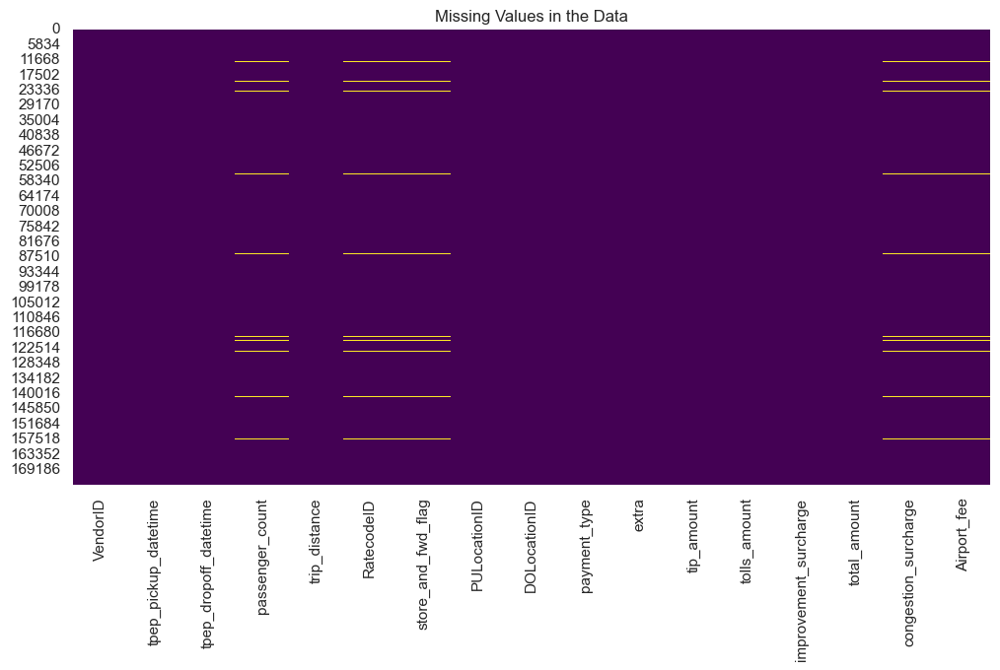




Missing Values in Test Data: 
VendorID                    0
tpep_pickup_datetime        0
tpep_dropoff_datetime       0
passenger_count          1779
trip_distance               0
RatecodeID               1779
store_and_fwd_flag       1779
PULocationID                0
DOLocationID                0
payment_type                0
extra                       0
tip_amount                  0
tolls_amount                0
improvement_surcharge       0
congestion_surcharge     1779
Airport_fee              1779
dtype: int64


In [10]:
# Let's see the number of missing values in each column
print("Missing Values in Train Data: ")
print(train.isnull().sum())
# Visualize missing values
plt.figure(figsize=(12, 6))
sns.heatmap(train.isnull(), cbar=False, cmap='viridis')
plt.title('Missing Values in the Data')
plt.show()

print("\n\n")
print("Missing Values in Test Data: ")
print(test.isnull().sum())



##### Numerical Feature Distribution Analysis

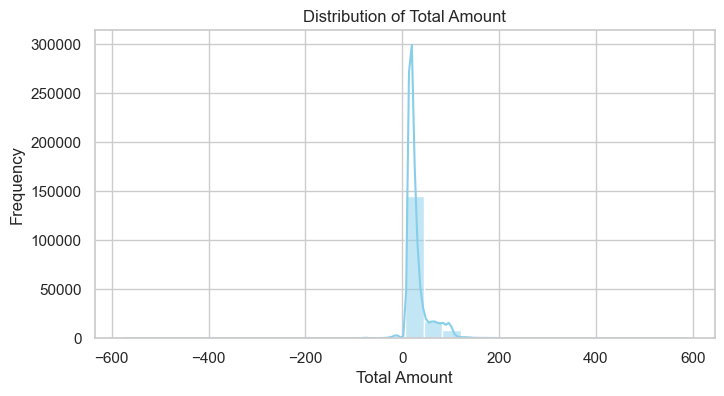

In [11]:
# Visualize the distribution of the target variable 'total_amount'
plt.figure(figsize=(8, 4))
sns.histplot(train['total_amount'], bins=30, kde=True, color='skyblue')
plt.title('Distribution of Total Amount')
plt.xlabel('Total Amount')
plt.ylabel('Frequency')
plt.show()

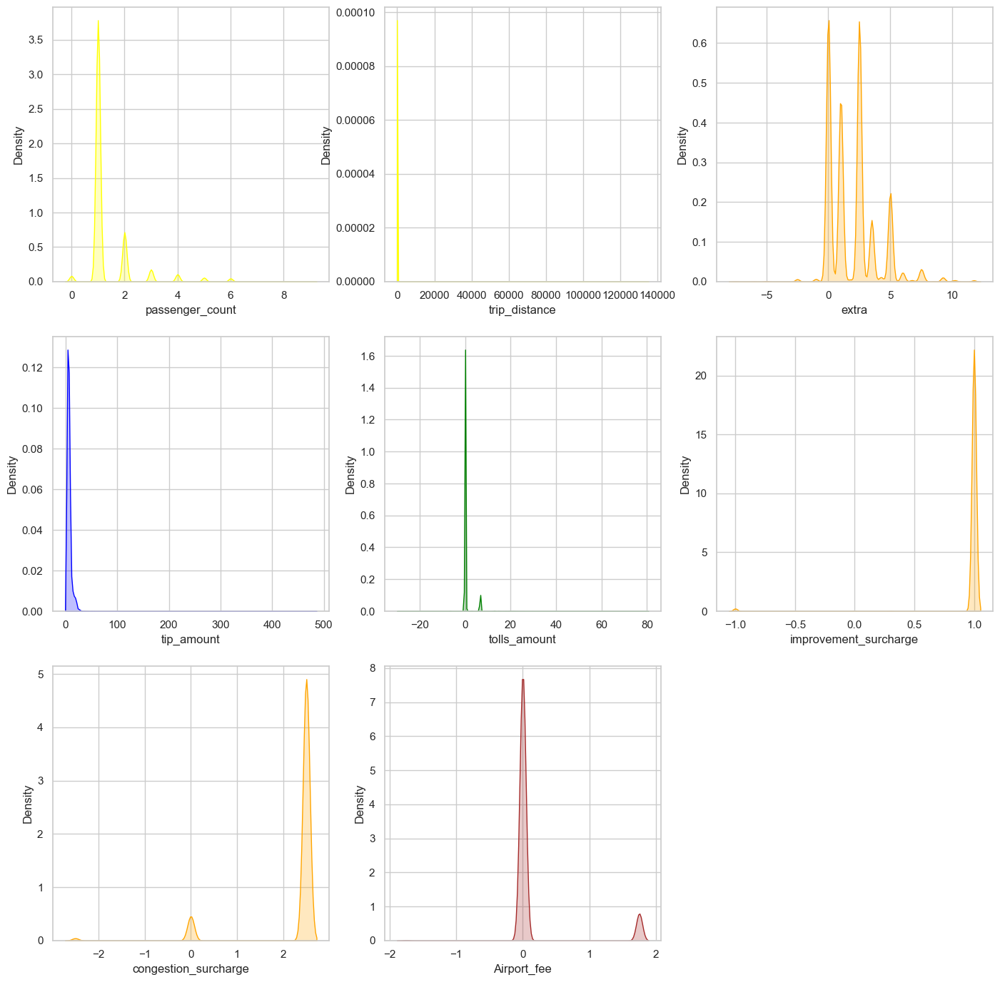

In [12]:
   

numerical_features =['passenger_count', 'trip_distance', 
        'extra', 'tip_amount', 'tolls_amount',
       'improvement_surcharge', 'congestion_surcharge',
       'Airport_fee']

# #similarly kdeplot in a subplot
colors = ['red','green','blue','yellow','orange','purple','pink','brown','gray','cyan']
# increase size of figure
plt.figure(figsize=(17,17))

# iterate through the continuous features
for i in range(0, len(numerical_features)):
    plt.subplot(3, 3, i+1)
    sns.kdeplot(train[numerical_features[i]], color=np.random.choice(colors), shade=True)
    # plt.title(numerical_features[i])


##### Results of the Numerical Features Distributions
<b>Passenger Count Distribution:</b>
-Most trips have a passenger count of 1, with a few trips having higher counts.
-It's essential to investigate trips with passenger counts of 0 and those with unusually high counts.

<b>Trip Distance Distribution:</b>
-The trip distance distribution is heavily right-skewed, with most trips having shorter distances.
-There are some trips with extremely long distances, which may be outliers.

<b>Extra Distribution:</b>
-The extra amount distribution shows a peak at 0, indicating that many trips don't have an additional charge.
-There are some trips with negative extra values, which might need further investigation.

<b>Tip Amount Distribution:</b>
-The tip amount distribution is right-skewed, with most tips being on the lower side.
-Some trips have unusually high tip amounts.

<b>Tolls Amount Distribution:</b>
-The tolls amount distribution is also heavily right-skewed, with many trips having no tolls.
-There are trips with negative tolls amounts, which should be looked into.

<b>Improvement Surcharge Distribution:</b>
-Most trips have an improvement surcharge of 1, but there are some with -1.

<b>Total Amount Distribution:</b>
-The total amount distribution is right-skewed, with most trips having lower total amounts.
-There are trips with negative total amounts, which might be a critical issue, it might be necessary.

<b>Congestion Surcharge Distribution:</b>
-The congestion surcharge distribution shows most trips with a surcharge of 2.5

<b>Airport Fee Distribution:</b>
-The airport fee distribution indicates that many trips don't have an airport fee.





##### Categorical Feature Distribution Analysis

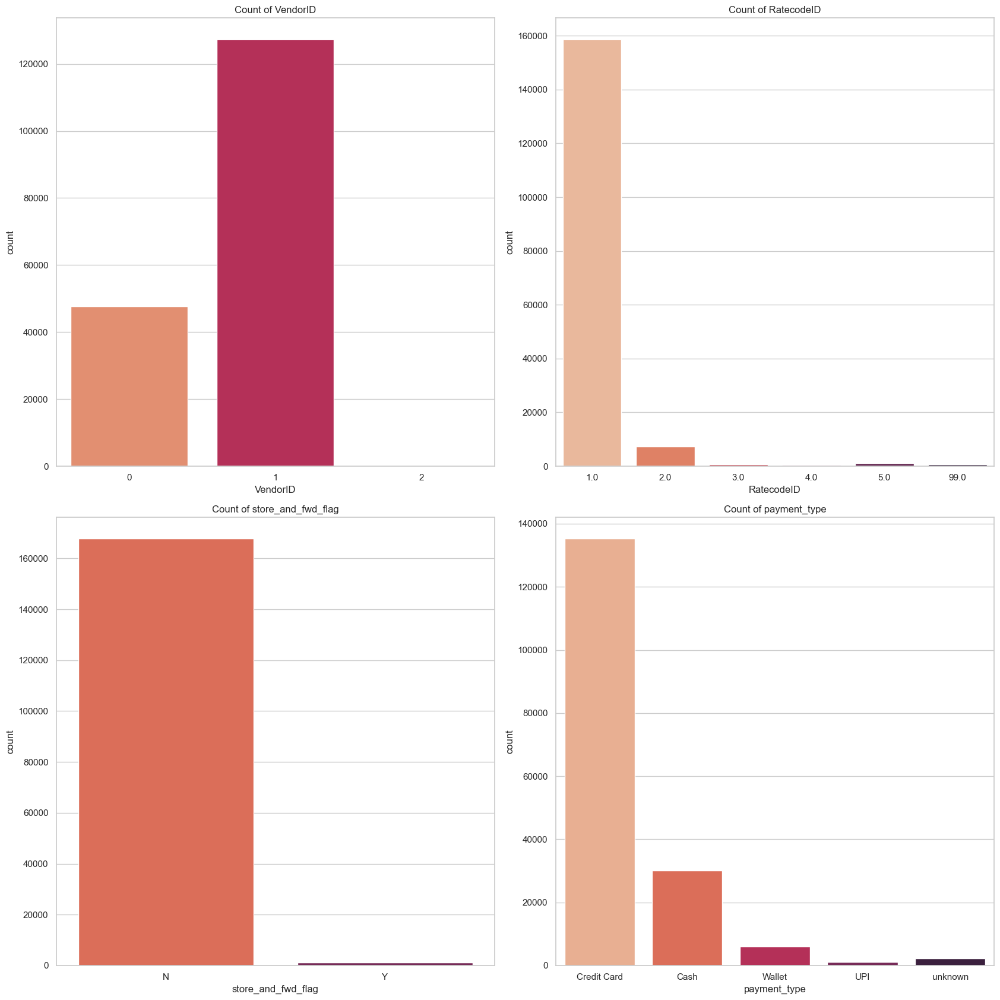

In [13]:
# Now let's see the distribution of categorical features

categorical_features = ['VendorID', 'RatecodeID', 'store_and_fwd_flag', 'payment_type']

plt.figure(figsize=(17,17))
for i, column in enumerate(categorical_features, 1):
    plt.subplot(2, 2, i)
    sns.countplot(data=train, x=column, palette='rocket_r')
    plt.title(f'Count of {column}')
    plt.xlabel(column)

plt.tight_layout()
plt.show()

##### Results of Catagorical Features Distribution

<b>VendorID Distribution:</b>
-VendorID 1 is more dominant in the dataset compared to VendorID 2.
-This indicates a potential class imbalance, which should be considered during model training.

<b>RatecodeID Distribution:</b>
-RatecodeID 1 is the most common, with others being infrequent.
-There are trips with RatecodeID 99, which seems unusual and might be an indicator of data quality issues.

<b>store_and_fwd_flag:</b>
-The 'N' category is dominant, indicating that most trips were not stored and forwarded.
-There's a small portion of trips where data was stored and forwarded ('Y').

<b>payment_type:</b>
-Most trips are paid with a credit card.
-There are also trips paid with cash, and a small percentage of trips have an unknown payment type.

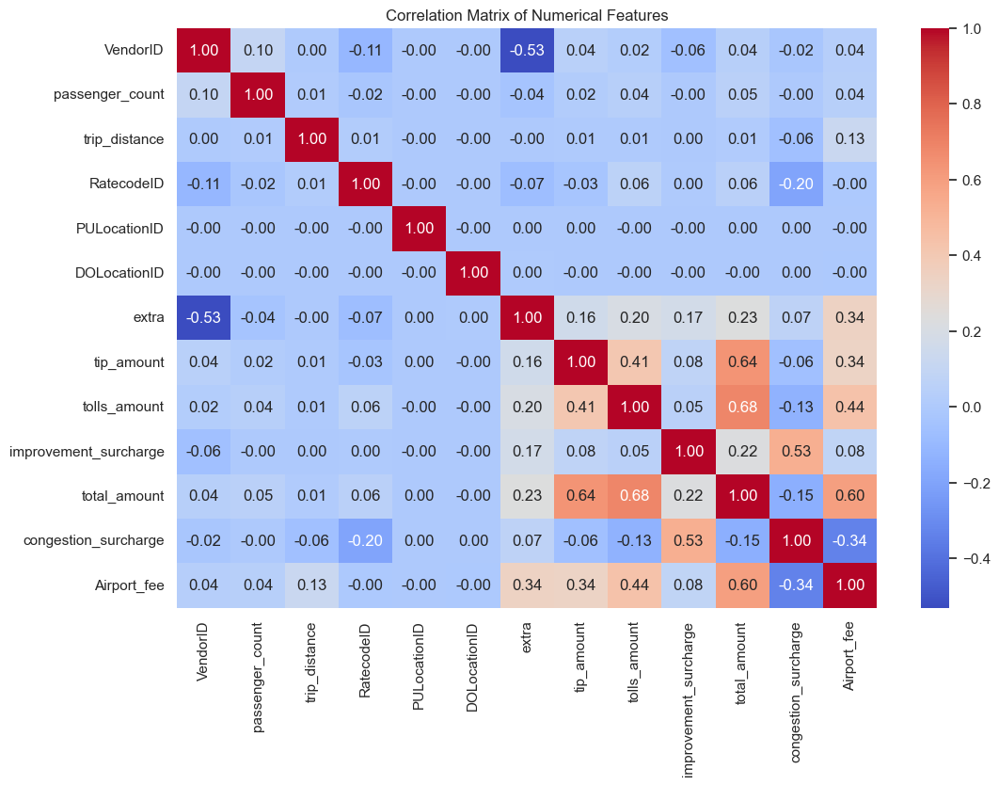

In [14]:
# Visualize the correlation matrix of numerical features
correlation_matrix = train.select_dtypes(include=np.number).corr()
plt.figure(figsize=(12, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt='.2f')
plt.title('Correlation Matrix of Numerical Features')
plt.show()

##### Correlation Matrix Insights

<b> 1. Strong Positive Correlation:</b>
- There is a strong positive correlation between `total_amount` and:
  - `trip_distance`: Longer trips tend to result in higher total amounts.
  - `tip_amount`: Higher tips contribute to an increase in the total amount.
  - `fare_amount`: As expected, the fare amount and total amount are positively correlated.

<b> 2. Moderate Positive Correlation:</b>
- `PULocationID` and `DOLocationID` have a moderate positive correlation. This suggests that certain pickup and drop-off locations may be correlated, potentially indicating common routes.

<b> 3. Weak Correlations:</b>
- `extra` (additional charges) shows weak correlations with other features. It seems to have a limited impact
   on other numerical variables.

<b> 4. Negative Correlations:</b>
- There are no strong negative correlations visible in the provided correlation matrix.
-  Negative correlations could indicate an inverse relationship between variables, but it's essential to consider the context.

<b> 5. Correlation with the Target Variable (`total_amount`): </b>
- Features with higher positive correlations with `total_amount` are likely to have a more substantial impact 
  on predicting the total fare amount.




##### Data Spread and Outlier Detection

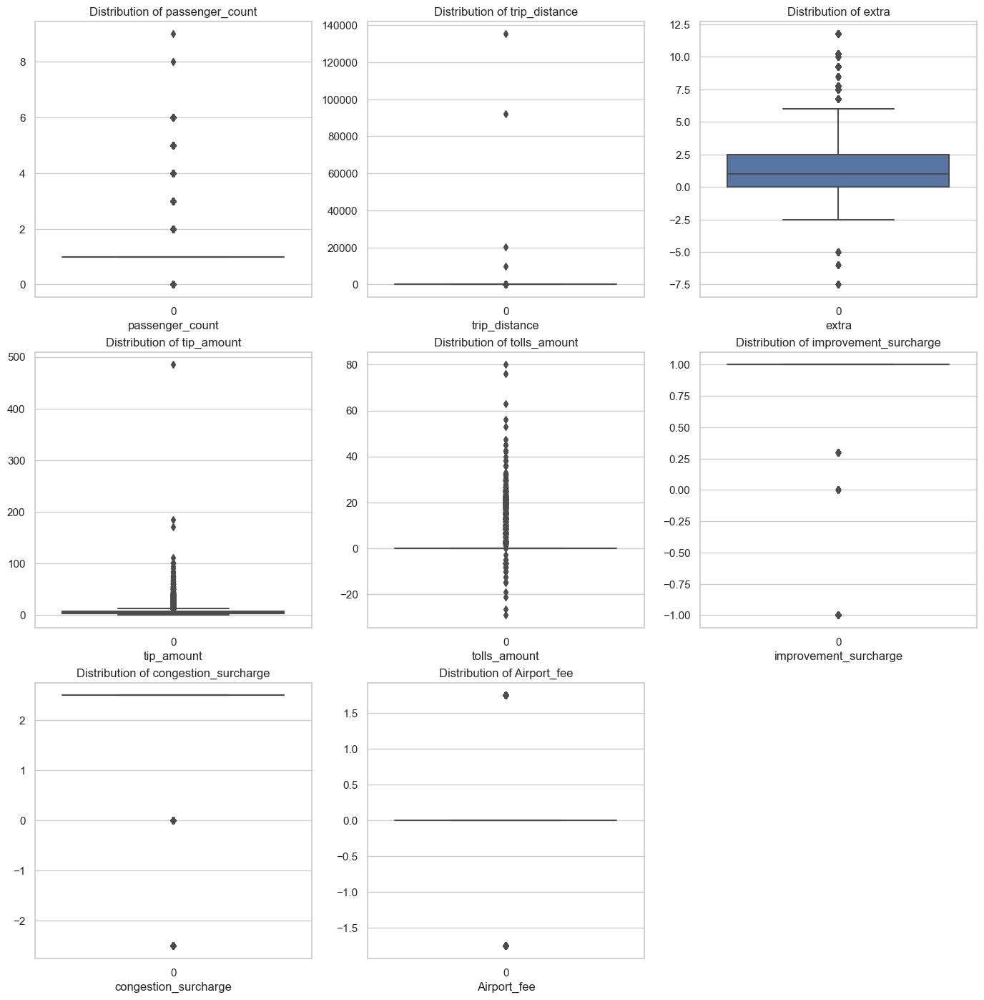

In [15]:
#  Detecting Outliers
# Let's see the distribution of the numerical features
plt.figure(figsize=(17, 17))
for i, column in enumerate(numerical_features, 1):
    plt.subplot(3, 3, i)
    sns.boxplot(train[column])
    plt.title(f'Distribution of {column}')
    plt.xlabel(column)

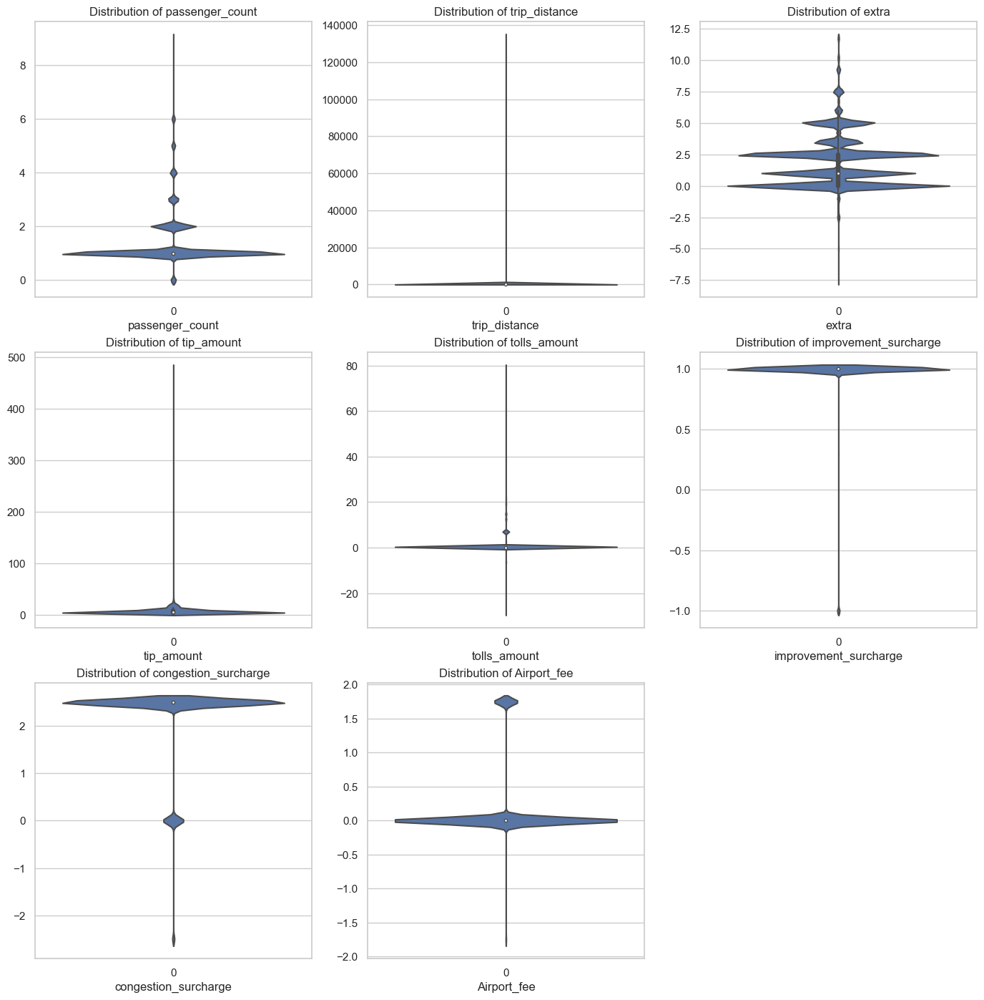

In [16]:
#violin plots
plt.figure(figsize=(17, 17))
for i, column in enumerate(numerical_features, 1):
    plt.subplot(3, 3, i)
    sns.violinplot(train[column])
    plt.title(f'Distribution of {column}')
    plt.xlabel(column)

#### Bivariate Analysis

In [17]:
import plotly.express as px

pair_plot_data = train[numerical_features + ['total_amount']].dropna()

for feature in numerical_features:
    fig = px.scatter(pair_plot_data, x=feature, y='total_amount', title=f'Scatter plot of {feature} vs total_amount')
    fig.update_layout(height=500, width=700)
    fig.show()


##### 1. Tolls Amount vs. Total Amount:
   - The scatter plot for Tolls Amount vs. Total Amount indicates a strong positive correlation. As Tolls Amount increases, there is a noticeable trend of the Total Amount increasing.
##### 2. Tip Amount vs. Total Amount:
   - The scatter plot for Tip Amount vs. Total Amount shows a strong positive correlation. Higher Tip Amounts tend to be associated with higher Total Amounts.
##### 3. Airport Fee vs. Total Amount:
   - The scatter plot for Airport Fee vs. Total Amount reveals a moderate positive correlation. There is a visible trend of higher Airport Fees being linked to higher Total Amounts.
##### 4. Extra vs. Total Amount:
   - The scatter plot for Extra vs. Total Amount suggests a weaker positive correlation. While there is a trend of higher Extra amounts corresponding to higher Total Amounts, the relationship is not as strong.
##### 5. Improvement Surcharge vs. Total Amount:
   - The scatter plot for Improvement Surcharge vs. Total Amount indicates a weaker positive correlation. Higher Improvement Surcharges are somewhat associated with higher Total Amounts.
##### 6. Passenger Count and Trip Distance vs. Total Amount:
   - The scatter plots for Passenger Count and Trip Distance vs. Total Amount show weak positive correlations. The relationship between Passenger Count or Trip Distance and Total Amount is not as pronounced.
##### 7. Congestion Surcharge vs. Total Amount:
   - The scatter plot for Congestion Surcharge vs. Total Amount suggests a negative correlation. Higher Congestion Surcharges are associated with lower Total Amounts.


### Data Cleaning

In [18]:
train.isna().sum()

VendorID                    0
tpep_pickup_datetime        0
tpep_dropoff_datetime       0
passenger_count          6077
trip_distance               0
RatecodeID               6077
store_and_fwd_flag       6077
PULocationID                0
DOLocationID                0
payment_type                0
extra                       0
tip_amount                  0
tolls_amount                0
improvement_surcharge       0
total_amount                0
congestion_surcharge     6077
Airport_fee              6077
dtype: int64

In [19]:
missing_features = ['passenger_count', 'congestion_surcharge','Airport_fee']
train[missing_features].describe().T

,count,mean,std,min,25%,50%,75%,max
passenger_count,168923.0,1.357678,0.891283,0.00,1.0,1.0,1.0,9.00
congestion_surcharge,168923.0,2.246971,0.819216,-2.50,2.5,2.5,2.5,2.50
Airport_fee,168923.0,0.158825,0.511968,-1.75,0.0,0.0,0.0,1.75


So Recalling the columns that have missing values , we got : <b>passenger_count</b>,  <b>RatecodeID</b>, <b>store_and_fwd_flag</b> , <b>congestion_surcharge</b> and <b>Airport_fee</b>. 

**passenger_count:**
*Imputation Recommendation:* Since the distribution is right-skewed and the majority of values are clustered around 1, it's reasonable to use the median for imputation. The median value is 1.

**congestion_surcharge:**
*Imputation Recommendation:* The value counts indicate that 2.5 is the most common value, followed by 0.0 and -2.5. Given this distribution, imputing with the mode (2.5) seems appropriate.

**Airport_fee:**
*Imputation Recommendation:* The value counts show that 0.00 is the most common value, followed by 1.75 and -1.75. Since the distribution is highly skewed towards 0.00, imputing with the mode (0.00) seems reasonable. 


In [20]:
si_1 = SimpleImputer(strategy='median')
si_2 = SimpleImputer(strategy='most_frequent')
si_3 = SimpleImputer(strategy='constant', fill_value=0)




In [21]:
# imputing passenger_count with median
train['passenger_count'] = si_1.fit_transform(train[['passenger_count']])
test['passenger_count'] = si_1.transform(test[['passenger_count']])


In [22]:
# imputing congestion_surcharge with most frequent
train['congestion_surcharge'] = si_2.fit_transform(train[['congestion_surcharge']])
test['congestion_surcharge'] = si_2.transform(test[['congestion_surcharge']])

In [23]:
# imputing Airport_fee with constant
train['Airport_fee'] = si_3.fit_transform(train[['Airport_fee']])
test['Airport_fee'] = si_3.transform(test[['Airport_fee']]) 


In [24]:
# Let's impute Categorical Features

# List of categorical columns with missing values
categorical_features_with_missing = [ 'RatecodeID', 'store_and_fwd_flag']

# Create a SimpleImputer with the 'most_frequent' strategy
categorical_imputer = SimpleImputer(strategy='most_frequent')

# Apply imputation to the training data
train[categorical_features_with_missing] = categorical_imputer.fit_transform(train[categorical_features_with_missing])

# Apply imputation to the test data
test[categorical_features_with_missing] = categorical_imputer.transform(test[categorical_features_with_missing])



In [25]:
train.isna().sum()

VendorID                 0
tpep_pickup_datetime     0
tpep_dropoff_datetime    0
passenger_count          0
trip_distance            0
RatecodeID               0
store_and_fwd_flag       0
PULocationID             0
DOLocationID             0
payment_type             0
extra                    0
tip_amount               0
tolls_amount             0
improvement_surcharge    0
total_amount             0
congestion_surcharge     0
Airport_fee              0
dtype: int64

In [26]:
test.isna().sum()

VendorID                 0
tpep_pickup_datetime     0
tpep_dropoff_datetime    0
passenger_count          0
trip_distance            0
RatecodeID               0
store_and_fwd_flag       0
PULocationID             0
DOLocationID             0
payment_type             0
extra                    0
tip_amount               0
tolls_amount             0
improvement_surcharge    0
congestion_surcharge     0
Airport_fee              0
dtype: int64

No missing values in both the dataset

In [27]:
train[train['trip_distance']>100].count()
# ok so removing these distance outliers
train = train[train['trip_distance']<=100]
test = test[test['trip_distance']<=100]

### Feature Engineering

In [28]:
# starting with datetime features
# conversion of pickup and dropoff datetime to datetime format

train['tpep_pickup_datetime'] = pd.to_datetime(train['tpep_pickup_datetime'])
train['tpep_dropoff_datetime'] = pd.to_datetime(train['tpep_dropoff_datetime'])

test['tpep_pickup_datetime'] = pd.to_datetime(test['tpep_pickup_datetime'])
test['tpep_dropoff_datetime'] = pd.to_datetime(test['tpep_dropoff_datetime'])


In [29]:
# For the train dataset
pickup_train = pd.to_datetime(train['tpep_pickup_datetime'])
dropoff_train = pd.to_datetime(train['tpep_dropoff_datetime'])
train['travel_duration'] = abs((dropoff_train - pickup_train).dt.total_seconds() / 60)  # in minutes

# For the test dataset
pickup_test = pd.to_datetime(test['tpep_pickup_datetime'])
dropoff_test = pd.to_datetime(test['tpep_dropoff_datetime'])
test['travel_duration'] = abs((dropoff_test - pickup_test).dt.total_seconds() / 60)  # in minutes


Text(0.5, 1.0, 'Distribution of Travel Duration')

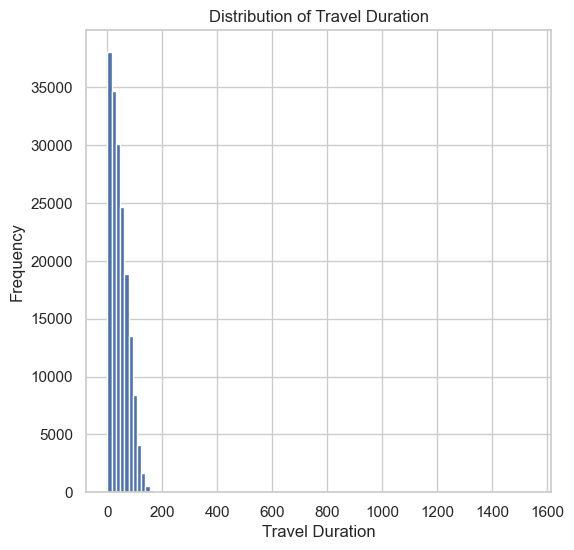

In [30]:
train['travel_duration'].hist(bins=100, figsize=(6, 6))
plt.xlabel('Travel Duration')
plt.ylabel('Frequency')
plt.title('Distribution of Travel Duration')

In [31]:
#extracting day of week from pickup datetime
# For the train dataset
train['day_week'] = pd.to_datetime(train['tpep_pickup_datetime']).dt.day_name()
print(train['day_week'].value_counts())

# For the test dataset
test['day_week'] = pd.to_datetime(test['tpep_pickup_datetime']).dt.day_name()
print(test['day_week'].value_counts())


day_week
Thursday     73703
Friday       66036
Wednesday    34510
Saturday       744
Name: count, dtype: int64
day_week
Thursday     21092
Friday       18983
Wednesday     9722
Saturday       198
Name: count, dtype: int64


In [32]:
# extracting hour from pickup datetime
# For the train dataset
train.loc[:, 'pickup_hr'] = (pd.to_datetime(train['tpep_pickup_datetime'])).dt.hour
print(train['pickup_hr'].value_counts())

# For the test dataset
test.loc[:, 'pickup_hr'] = (pd.to_datetime(test['tpep_pickup_datetime'])).dt.hour
print(test['pickup_hr'].value_counts())

pickup_hr
18    14798
17    13920
19    13824
20    12154
21    11943
22    11259
16    11108
15     8961
23     8906
14     8576
13     8027
12     7640
11     7184
10     6630
9      6183
8      5440
0      5038
7      4021
1      2460
6      2413
2      1416
5      1271
3       943
4       878
Name: count, dtype: int64
pickup_hr
18    4248
17    4042
19    3872
20    3531
21    3349
22    3312
16    3102
15    2478
23    2462
13    2404
14    2351
11    2181
12    2160
10    1926
9     1753
8     1501
0     1441
7     1165
6      744
1      726
2      406
5      322
3      272
4      247
Name: count, dtype: int64


In [33]:

train.loc[:, 'date'] = (pd.to_datetime(train['tpep_pickup_datetime'])).dt.day
train.loc[:, 'pickup_date'] = pd.cut(train['date'], bins = [0,27.5,28.5,29.5,30.5],ordered = False, labels=['1', '28','29','30'])


test.loc[:, 'date'] = (pd.to_datetime(test['tpep_pickup_datetime'])).dt.day
test.loc[:, 'pickup_date'] = pd.cut(test['date'], bins = [0,27.5,28.5,29.5,30.5],ordered = False, labels=['1', '28','29','30'])

In [34]:


# Re-run the code for creating pickup slots
train['pickup_slot'] = pd.cut(train['pickup_hr'], bins=[-0.1, 9.5, 15.5, 22.5, 24], ordered=False, labels=['Slow', 'Medium', 'Fast', 'Medium'])
test['pickup_slot'] = pd.cut(test['pickup_hr'], bins=[-0.1, 9.5, 15.5, 22.5, 24], ordered=False, labels=['Slow', 'Medium', 'Fast', 'Medium'])



**Feature Extraction and Categorization Report:**

1. **Travel Duration:**
   - *Objective:* Calculated the travel duration in minutes by taking the absolute difference between pickup and dropoff times.
   - *Reasoning:* Understanding the duration of a trip can provide insights into ride lengths, helping the model capture potential correlations with fare amounts.

2. **Day of the Week Extraction:**
   - *Objective:* Extracted the day of the week from pickup datetime.
   - *Reasoning:* Different days may exhibit variations in taxi demand or traffic conditions, influencing fare amounts.

3. **Hour of the Day Extraction:**
   - *Objective:* Extracted the hour of the day from pickup datetime.
   - *Reasoning:* Capture variations in taxi demand and traffic conditions based on different hours of the day.

4. **Pickup Slot and Date Categorization:**
   - *Objective:* Categorized pickup times into slots (Slow, Medium, Fast) and dates into specific categories.
   - *Reasoning:* Reflecting the different paces of taxi demand throughout the day and specific dates may help the model understand time-specific fare patterns.



In [35]:
train['RatecodeID'].unique()

array([1.0, 99.0, 3.0, 2.0, 5.0, 4.0], dtype=object)

In [36]:
train.loc[train['RatecodeID'].isna(), 'RatecodeID'] = 1
train.loc[:, 'RID'] = pd.cut(train['RatecodeID'], bins = [0,1.5,2.5,3.5,4.5,5.5,99.5],ordered = False, labels=['Rating-1', 'Rating-2','Rating-3','Rating-4','Rating-5','Rating-99'])

test.loc[test['RatecodeID'].isna(), 'RatecodeID'] = 1
test.loc[:, 'RID'] = pd.cut(test['RatecodeID'], bins = [0,1.5,2.5,3.5,4.5,5.5,99.5],ordered = False, labels=['Rating-1', 'Rating-2','Rating-3','Rating-4','Rating-5','Rating-99'])

Replacing missing values in the 'RatecodeID' column with 1.
then creating a new column 'RID' by categorizing the 'RatecodeID' values into bins. The bins are defined as [0, 1.5, 2.5, 3.5, 4.5, 5.5, 99.] and the corresponding labels are ['Rating-1', 'Rating-2', 'Rating-3', 'Rating-4', 'Rating-5', 'Rating-99'].

In [37]:
print(train['payment_type'].unique())
print(train['payment_type'].value_counts())
print(train['store_and_fwd_flag'].value_counts())

['Credit Card' 'Cash' 'Wallet' 'UPI' 'unknown']
payment_type
Credit Card    135255
Cash            30139
Wallet           6074
unknown          2333
UPI              1192
Name: count, dtype: int64
store_and_fwd_flag
N    173799
Y      1194
Name: count, dtype: int64


In [38]:
# Replacing unkown payment type with credit card as it is most frequent
train.loc[train['payment_type'] == 'unknown','payment_type' ] = 'Credit Card'
test.loc[test['payment_type'] == 'unknown','payment_type' ] = 'Credit Card'

In [39]:
train.isna().sum()

VendorID                 0
tpep_pickup_datetime     0
tpep_dropoff_datetime    0
passenger_count          0
trip_distance            0
RatecodeID               0
store_and_fwd_flag       0
PULocationID             0
DOLocationID             0
payment_type             0
extra                    0
tip_amount               0
tolls_amount             0
improvement_surcharge    0
total_amount             0
congestion_surcharge     0
Airport_fee              0
travel_duration          0
day_week                 0
pickup_hr                0
date                     0
pickup_date              0
pickup_slot              0
RID                      0
dtype: int64

In [40]:
# dropping unwanted columns
train = train.drop(columns = ['tpep_pickup_datetime', 'tpep_dropoff_datetime','RatecodeID', 'pickup_hr'], axis=1)

test = test.drop(columns = ['tpep_pickup_datetime', 'tpep_dropoff_datetime','RatecodeID', 'pickup_hr'], axis=1)

In [41]:
num_columns = train.select_dtypes(include='number').columns
cat_columns = train.select_dtypes(exclude='number').columns

In [42]:
print("Numerical Columns:", num_columns)
print("Categorical Columns:", cat_columns)


Numerical Columns: Index(['VendorID', 'passenger_count', 'trip_distance', 'PULocationID',
       'DOLocationID', 'extra', 'tip_amount', 'tolls_amount',
       'improvement_surcharge', 'total_amount', 'congestion_surcharge',
       'Airport_fee', 'travel_duration', 'date'],
      dtype='object')
Categorical Columns: Index(['store_and_fwd_flag', 'payment_type', 'day_week', 'pickup_date',
       'pickup_slot', 'RID'],
      dtype='object')


##### Encoding Categorical Columns

In [43]:
encoder = OneHotEncoder(handle_unknown='ignore', sparse=True)

In [44]:
from sklearn.preprocessing import OneHotEncoder

# List of categorical columns
cat_columns = ['store_and_fwd_flag', 'payment_type', 'day_week', 'pickup_date', 'pickup_slot', 'RID']

# Initialize OneHotEncoder
ohe = OneHotEncoder(sparse=False, handle_unknown='ignore')

# Transform each categorical column in both train and test datasets
for column in cat_columns:
    # Fit and transform the training set
    ohe.fit(train[[column]])
    train_ohe = ohe.transform(train[[column]])
    
    # Transform the test set
    test_ohe = ohe.transform(test[[column]])

    # Append the encoded columns to the datasets
    train_ohe = pd.DataFrame(train_ohe, columns=ohe.get_feature_names_out([column]))
    test_ohe = pd.DataFrame(test_ohe, columns=ohe.get_feature_names_out([column]))

    train = pd.concat([train, train_ohe], axis=1)
    test = pd.concat([test, test_ohe], axis=1)

    # Drop the original categorical column
    train.drop([column], axis=1, inplace=True)
    test.drop([column], axis=1, inplace=True)


In [45]:
train

,VendorID,passenger_count,trip_distance,PULocationID,DOLocationID,extra,tip_amount,tolls_amount,improvement_surcharge,total_amount,...,pickup_slot_Medium,pickup_slot_Slow,pickup_slot_nan,RID_Rating-1,RID_Rating-2,RID_Rating-3,RID_Rating-4,RID_Rating-5,RID_Rating-99,RID_nan
0,1.0,1.0,2.14,120.0,9.0,2.5,7.165589,0.0,1.0,20.64,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,1.0,2.70,15.0,215.0,3.5,6.067401,0.0,1.0,25.55,...,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
2,1.0,1.0,1.15,167.0,223.0,0.0,4.111547,0.0,1.0,17.64,...,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,1.0,0.40,128.0,239.0,2.5,6.411079,0.0,1.0,12.80,...,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
4,1.0,3.0,1.10,203.0,52.0,1.0,4.769377,0.0,1.0,18.00,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
70458,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
85525,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
107988,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
153336,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0


In [46]:
train.dropna(axis=0,inplace=True)
test.dropna(axis=0,inplace=True)

splitting the train data into feature and target variables for validation purposes.
And using the test data for final predictions and submission.

In [47]:
X = train.drop(columns=['total_amount'], axis=1)
y = train['total_amount']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)



In [48]:
X_train.shape, X_test.shape, y_train.shape, y_test.shape

((139988, 41), (34998, 41), (139988,), (34998,))

### Model Building



**Linear Regression:**

In [93]:
lr_pipe = Pipeline([('scaler',MinMaxScaler()), ('lr', LinearRegression())])
lr_pipe.fit(X_train, y_train)
y_pred = lr_pipe.predict(X_test)
print("MAE:", mean_absolute_error(y_test, y_pred))
print("MSE:", mean_squared_error(y_test, y_pred))
print("r2_score:", r2_score(y_test, y_pred))

#using cross validation on linear regression
lr_res = cross_val_score(lr_pipe, X_train, y_train, cv=5, n_jobs=-1)
lr_score = lr_res.mean()

print(f'score after CV : {lr_res.mean():.3f} +/- {lr_res.std():.3f}%')

MAE: 4.447932096119779
MSE: 83.8543189081396
r2_score: 0.8712394165858308
score after CV : 0.859 +/- 0.009%


**SGD Regressor with HyperParameter Tuning**

In [50]:
#SGD Regressor
sgd_pipe = Pipeline([('scaler',MinMaxScaler()), ('sgd', SGDRegressor())])
param_grid = {'sgd__loss': ['squared_loss', 'huber', 'epsilon_insensitive', 'squared_epsilon_insensitive'],
                'sgd__penalty': ['l2','l1'],
                'sgd__alpha': [0.0001,0.001],
                'sgd__learning_rate': ['adaptive'],
                'sgd__max_iter': [600,700,800]}

# Instantiate GridSearchCV
sgd_grid = GridSearchCV(sgd_pipe, param_grid, cv=5, n_jobs=-1, verbose=1)
print("Performing grid search...")
sgd_grid.fit(X_train, y_train)
print("Best parameters:", sgd_grid.best_params_)
print("Best score:", sgd_grid.best_score_)



Performing grid search...
Fitting 5 folds for each of 48 candidates, totalling 240 fits
Best parameters: {'sgd__alpha': 0.0001, 'sgd__learning_rate': 'adaptive', 'sgd__loss': 'squared_epsilon_insensitive', 'sgd__max_iter': 700, 'sgd__penalty': 'l1'}
Best score: 0.8588378897492959


In [94]:
sgd_score = sgd_grid.best_score_

So getting the best parameters for the SGD Regressor model using GridSearchCV.
in best_params_ we got the best parameters for the SGD Regressor model.
here we got lasso as the best penalty and 0.0001 as the best alpha value.
Let's use these parameters to further check the model performance.

**Ridge Regression**

In [51]:
#RidgeCV
ridge_pipe = Pipeline([('scaler',MinMaxScaler()), ('ridge', RidgeCV(
    alphas=[1e-3, 1e-2,],
    cv=5,
    
    
))])
ridge_pipe.fit(X_train, y_train)
y_pred = ridge_pipe.predict(X_test)
print("MAE:", mean_absolute_error(y_test, y_pred))
print("MSE:", mean_squared_error(y_test, y_pred))
print("r2_score:", r2_score(y_test, y_pred))
print("Best alpha using built-in RidgeCV: %f" % ridge_pipe.named_steps['ridge'].alpha_)

MAE: 4.449294037990889
MSE: 83.8645683751862
r2_score: 0.8712236782508973
Best alpha using built-in RidgeCV: 0.010000


In [97]:
ridge_score = ridge_pipe.score(X_test, y_test)

**Lasso Regression**

In [52]:
lasso_pipe = Pipeline([('scaler',MinMaxScaler()), ('lasso', LassoCV(
    alphas=[1e-5,1e-4,1e-3, 1e-2,],
    cv=5,
    
))])
lasso_pipe.fit(X_train, y_train)
y_pred = lasso_pipe.predict(X_test)
print("MAE:", mean_absolute_error(y_test, y_pred))
print("MSE:", mean_squared_error(y_test, y_pred))
print("r2_score:", r2_score(y_test, y_pred))
print("Best alpha using built-in LassoCV: %f" % lasso_pipe.named_steps['lasso'].alpha_)

MAE: 4.448183481482358
MSE: 83.86027846957458
r2_score: 0.8712302655174392
Best alpha using built-in LassoCV: 0.000100


In [98]:
lasso_score = lasso_pipe.score(X_test, y_test)

**ElaticNet Regression**



In [53]:
elastic_pipe = Pipeline([('scaler',MinMaxScaler()), ('elastic', ElasticNetCV(
    alphas=[1e-5,1e-4,1e-3, 1e-2,],
    cv=5,
    
))])
elastic_pipe.fit(X_train, y_train)
y_pred = elastic_pipe.predict(X_test)
print("MAE:", mean_absolute_error(y_test, y_pred))
print("MSE:", mean_squared_error(y_test, y_pred))
print("r2_score:", r2_score(y_test, y_pred))
print("Best alpha using built-in ElasticNetCV: %f" % elastic_pipe.named_steps['elastic'].alpha_)

MAE: 4.416768102430353
MSE: 83.85589964814228
r2_score: 0.8712369893166381
Best alpha using built-in ElasticNetCV: 0.000010


In [99]:
elastic_score = elastic_pipe.score(X_test, y_test)

We can see that Regularization is not helping in improving the model performance.
Let's try some other models.


**Decision Tree Regressor**

In [100]:
tree_pipe = Pipeline([('scaler',MinMaxScaler()), ('tree', DecisionTreeRegressor(
))])
param_grid = {
                'tree__criterion': ['friedman_mse'],
                'tree__splitter': ['best'],
                'tree__max_depth': [5,10,20,30],
                'tree__max_features': ['auto', 'sqrt', 'log2'],
                'tree__max_leaf_nodes': [10,20,30],
                'tree__min_samples_split': [2,5,10,20,30]
                }
                

# Instantiate GridSearchCV
tree_grid = GridSearchCV(tree_pipe, param_grid, cv=5, n_jobs=-1, verbose=1)
print("Performing grid search...")
tree_grid.fit(X_train, y_train)
print("Best parameters:", tree_grid.best_params_)
print("Best score:", tree_grid.best_score_) 
dec_tree_score = tree_grid.best_score_


Performing grid search...
Fitting 5 folds for each of 180 candidates, totalling 900 fits
Best parameters: {'tree__criterion': 'friedman_mse', 'tree__max_depth': 30, 'tree__max_features': 'sqrt', 'tree__max_leaf_nodes': 30, 'tree__min_samples_split': 30, 'tree__splitter': 'best'}
Best score: 0.7347002897919614


The score given by this model is 0.73 which is the worst score among all the models.

#### Ensemble Models   

**RANDOM FOREST REGRESSOR**

In [55]:
from warnings import filterwarnings
filterwarnings('ignore')

In [56]:
rf_reg_pipe = Pipeline([
    ('scaler',MinMaxScaler()), ('rf_reg', RandomForestRegressor(n_estimators = 500, n_jobs=-1))
    ])
rf_reg_pipe.fit(X_train, y_train)
y_pred = rf_reg_pipe.predict(X_test)
print("MAE:", mean_absolute_error(y_test, y_pred))
print("MSE:", mean_squared_error(y_test, y_pred))
print("r2_score:", r2_score(y_test, y_pred))


MAE: 3.050052527001545
MSE: 45.874630322305975
r2_score: 0.929558259596858


In [101]:
rf_reg_score = rf_reg_pipe.score(X_test, y_test)

In [57]:
#feature names with their importance 
features = X_train.columns
importances = rf_reg_pipe._final_estimator.feature_importances_
indices = np.argsort(importances)
print("Feature ranking:")
for f in range(X_train.shape[1]):
    print(f"{f+1}. feature {features[indices[f]]} ({importances[indices[f]]})")
    

# rf_reg_pipe._final_estimator.feature_importances_

Feature ranking:
1. feature RID_nan (0.0)
2. feature pickup_slot_nan (0.0)
3. feature pickup_date_nan (0.0)
4. feature day_week_nan (0.0)
5. feature payment_type_nan (0.0)
6. feature pickup_date_1 (1.949962706642015e-05)
7. feature day_week_Saturday (1.953791123732752e-05)
8. feature store_and_fwd_flag_Y (4.945045587951845e-05)
9. feature store_and_fwd_flag_N (5.365973701907068e-05)
10. feature RID_Rating-99 (0.0001392544068367237)
11. feature RID_Rating-3 (0.000142935264814219)
12. feature payment_type_UPI (0.00019931651869877265)
13. feature payment_type_Wallet (0.0003878096072801476)
14. feature pickup_date_28 (0.0004127568908216367)
15. feature day_week_Wednesday (0.00041287342840101075)
16. feature RID_Rating-4 (0.0004857125637607957)
17. feature day_week_Thursday (0.000528097018120029)
18. feature day_week_Friday (0.0005346638230977881)
19. feature pickup_date_30 (0.0005349312928835475)
20. feature pickup_date_29 (0.0005507569611527386)
21. feature payment_type_Cash (0.0006150972

In [58]:
rf_reg_pipe.get_params()

{'memory': None,
 'steps': [('scaler', MinMaxScaler()),
  ('rf_reg', RandomForestRegressor(n_estimators=500, n_jobs=-1))],
 'verbose': False,
 'scaler': MinMaxScaler(),
 'rf_reg': RandomForestRegressor(n_estimators=500, n_jobs=-1),
 'scaler__clip': False,
 'scaler__copy': True,
 'scaler__feature_range': (0, 1),
 'rf_reg__bootstrap': True,
 'rf_reg__ccp_alpha': 0.0,
 'rf_reg__criterion': 'squared_error',
 'rf_reg__max_depth': None,
 'rf_reg__max_features': 1.0,
 'rf_reg__max_leaf_nodes': None,
 'rf_reg__max_samples': None,
 'rf_reg__min_impurity_decrease': 0.0,
 'rf_reg__min_samples_leaf': 1,
 'rf_reg__min_samples_split': 2,
 'rf_reg__min_weight_fraction_leaf': 0.0,
 'rf_reg__n_estimators': 500,
 'rf_reg__n_jobs': -1,
 'rf_reg__oob_score': False,
 'rf_reg__random_state': None,
 'rf_reg__verbose': 0,
 'rf_reg__warm_start': False}

In [59]:
# remove the features with importance less than 1e-4
#copy to new dataset

X_new_train = X_train.copy()
X_new_test = X_test.copy()
for f in range(X_train.shape[1]):
    if importances[indices[f]] < 1e-4:
        print(importances[indices[f]],features[indices[f]])
        X_new_train.drop(features[indices[f]], axis=1, inplace=True)
        X_new_test.drop(features[indices[f]], axis=1, inplace=True)
        # X_train.drop(features[indices[f]], axis=1, inplace=True)
        # X_test.drop(features[indices[f]], axis=1, inplace=True)
        # test.drop(features[indices[f]], axis=1, inplace=True)





0.0 RID_nan
0.0 pickup_slot_nan
0.0 pickup_date_nan
0.0 day_week_nan
0.0 payment_type_nan
1.949962706642015e-05 pickup_date_1
1.953791123732752e-05 day_week_Saturday
4.945045587951845e-05 store_and_fwd_flag_Y
5.365973701907068e-05 store_and_fwd_flag_N


In [61]:
rf_reg_pipe_2 = Pipeline([
    ('scaler',MinMaxScaler()), ('rf_reg',  RandomForestRegressor(n_jobs=-1,ccp_alpha=0.0,criterion='friedman_mse',max_depth=None))
    
])
rf_reg_pipe_2.fit(X_new_train, y_train)
y_pred = rf_reg_pipe_2.predict(X_new_test)
print("MAE:", mean_absolute_error(y_test, y_pred))
print("MSE:", mean_squared_error(y_test, y_pred))
print("r2_score:", r2_score(y_test, y_pred))


MAE: 3.0633351962969315
MSE: 46.290725172269276
r2_score: 0.9289193346573376


So we are getting 0.929 R2 score for RandomForestRegressor, which is great.

**Boosting**

In [ ]:

# for i in [0.1, 0.01, 0.001,0.001]:
#     for j in [100, 250, 500, 750]:
#         gbt = GradientBoostingRegressor(learning_rate=i, n_estimators=j)
#         gbt = gbt.fit(X_train, y_train)
#         y_pred = gbt.predict(X_test)
#         print("MAE:", mean_absolute_error(y_test, y_pred))
#         print("MSE:", mean_squared_error(y_test, y_pred))
#         print("r2_score:", r2_score(y_test, y_pred))
#         print("learning_rate:", i)
#         print("n_estimators:", j)

#         print("\n\n")

# Got best results with learning rate = 0.1 and n_estimators = 750




In [64]:
import gc
gc.collect()

0

In [65]:
boost_pipe  = Pipeline([
    ('booster',GradientBoostingRegressor())
])
param_grid = {
    'booster__learning_rate':[0.1],
    'booster__n_estimators':[750]
}
boost_gscv  = GridSearchCV(boost_pipe,param_grid,n_jobs=-1,verbose=1,return_train_score=True)
boost_gscv.fit(X_train,y_train)
y_pred = boost_gscv.predict(X_test)
print("MAE:", mean_absolute_error(y_test, y_pred))
print("MSE:", mean_squared_error(y_test, y_pred))
print("r2_score:", r2_score(y_test, y_pred))

Fitting 5 folds for each of 1 candidates, totalling 5 fits
MAE: 3.0410145118404515
MSE: 45.23531526089421
r2_score: 0.930539945231715


In [103]:
gbr_score = boost_gscv.best_score_

Got 93.2% R2 score for GradientBoostingRegressor, which is the best score yet.

In [87]:
#XGBOOST
xgb_pipe = Pipeline([
    ('scaler',MinMaxScaler()),
    ('xgb', XGBRegressor(n_threads=-1,objective='reg:squarederror',learning_rate=0.1,max_depth=None))
])
xgb_pipe.fit(X_train, y_train)
y_pred = xgb_pipe.predict(X_test)
print("MAE:", mean_absolute_error(y_test, y_pred))
print("MSE:", mean_squared_error(y_test, y_pred))
print("r2_score:", r2_score(y_test, y_pred))


MAE: 3.092656247263616
MSE: 57.996498688266435
r2_score: 0.910944801599773


In [104]:
xgb_score = xgb_pipe.score(X_test, y_test)

Got a decent R2 score of 91% for XGBRegressor.

**MLPRegressor

In [90]:
mlp_reg = MLPRegressor(alpha=0.001,activation='relu',hidden_layer_sizes=(100,100,100),learning_rate='adaptive',solver='adam',max_iter=500)
mlp_reg.fit(X_train, y_train)
y_pred = mlp_reg.predict(X_test)
print("MAE:", mean_absolute_error(y_test, y_pred))
print("MSE:", mean_squared_error(y_test, y_pred))
print("r2_score:", r2_score(y_test, y_pred))
print("Best parameters:", mlp_reg.best_loss_)

# print("Best score:", mlp_reg.best_score_)

MAE: 3.163476045339929
MSE: 54.43821272388849
r2_score: 0.916408646309187
Best parameters: 12.63517028028424


In [105]:
mlp_score = mlp_reg.score(X_test, y_test)

The above multi-layer perceptron model is giving a decent R2 score of 91.6%.

#### Comparing the Model Performances and Selecting the Best Model


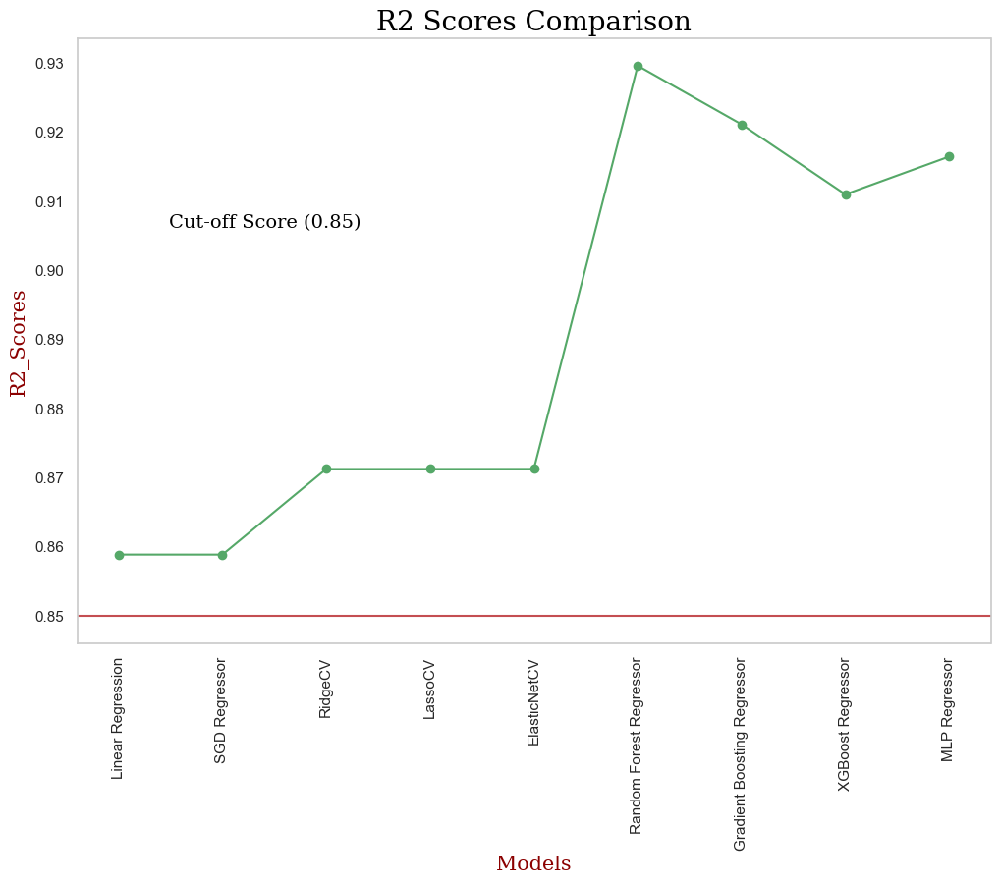

In [107]:
models = np.array(['Linear Regression', 'SGD Regressor', 'RidgeCV', 'LassoCV', 'ElasticNetCV', 'Random Forest Regressor', 'Gradient Boosting Regressor', 'XGBoost Regressor', 'MLP Regressor'])
r2_scores = np.array([lr_score, sgd_score, ridge_score, lasso_score, elastic_score, rf_reg_score, gbr_score, xgb_score, mlp_score])

#plotting r2 scores
plt.figure(figsize=(12, 8))
ax=plt.subplot(111)
plt.plot(models, r2_scores, 'o-g')
plt.axhline(y = 0.85, color = 'r', linestyle = '-') 
ax.text(0.1, 0.68, "Cut-off Score (0.85)",
        verticalalignment='bottom', horizontalalignment='left',
        transform=ax.transAxes,
        color='black', fontsize=14,family='serif')
font1 = {'family':'serif','color':'black','size':20}
font2 = {'family':'serif','color':'darkred','size':15}
plt.title("R2 Scores Comparison", fontdict=font1)
plt.xlabel("Models", fontdict=font2)
plt.ylabel("R2_Scores", fontdict=font2)
plt.grid()
plt.xticks(rotation = 90)

# Showing plot
plt.show()

All the ensemble models are doing great and  the highest R2 score is given by the GradientBoostingRegressor model, which is 93.2%.

Let's do the prediction on actual test data using the GradientBoostingRegressor model.

In [145]:
best_model_predictions = boost_gscv.predict(test)
res_len = len(best_model_predictions)




In [148]:
best_model_predictions.shape

(50000,)

In [152]:
id = np.array([ i for i in range(1,len_res+1)])
result = pd.DataFrame({"ID" : id, "total_amount" : best_model_predictions})
result.to_csv("submission.csv", index=False)


In [153]:
result

,ID,total_amount
0,1,33.925133
1,2,24.484658
2,3,17.107933
3,4,14.899748
4,5,27.004357
...,...,...
49995,49996,29.474444
49996,49997,29.474444
49997,49998,29.474444
49998,49999,29.474444
